In [1]:
from glob import glob
import matplotlib.pyplot as plt
import pandas as pd
import torch
import torch.nn.functional as F

from omegaconf import OmegaConf
from app.utils import get_data

# INIT

Pour projet j'ai utilisé Omegaconf et Hydra pour la gestion des configurations du projet. C'est une approche simple et flexible qui permet d'utiliser l'objet `DictConfig` `cfg` comme interface d'accès à toutes les configurations.

In [2]:
OmegaConf.register_new_resolver("eval", resolver=eval, replace=True)
cfg = OmegaConf.load("../src/app/config/config.yaml")

# EDA

## Compréhension du dataset

Dans le but de faire de la cross validation, nous avons aléatoirement séparé les données en `5 folds` dans le fichier `byu_folded_tomograms_seed57.csv`.
Ce fichier consiste au fichier `train_labels.csv` de départ auquel nous avons ajouté la colonne `fold` en plus de renommer les colonnes. Pour ce faire nous avons utilisé le code ci-dessous.

In [3]:
cfg.df_path = (
    "/kaggle/input/drx75c-byu-ds01-folded-tomograms/byu_folded_tomograms_seed57.csv"
)

In [4]:
df = pd.read_csv(cfg.df_path)

In [5]:
df.head()

,row_id,tomo_id,z,y,x,axis0,axis1,axis2,vxs,n_motors,id,fold
0,0,tomo_003acc,-1.0,-1.0,-1.0,500,1912,1847,6.5,0,0,6
1,1,tomo_00e047,169.0,546.0,603.0,300,959,928,15.6,1,1,5
2,2,tomo_00e463,235.0,403.0,137.0,500,924,956,19.7,6,2,6
3,3,tomo_00e463,243.0,363.0,153.0,500,924,956,19.7,6,2,6
4,4,tomo_00e463,222.0,379.0,144.0,500,924,956,19.7,6,2,6


Un couple `(z, y, x)` représente les coordonnées d'un moteur dans un tomogramme (image 3D) respectivement sur ses dimentions `0, 1 et 2`. La valeur `-1` dans ces coordonnées signifie que ce tomogramme ne contient pas de moteurs. un couple (axis0, axis1, axis2) constitue la taille du tomogramme dans lequel se trouve le moteur sur chacune des trois dimensions `0, 1 et 2`.
- la `dimension 0` représente le nombre de canaux de l'image ou encore `profondeur de l'image`
- la `dimension 1` représente la `hauteur de l'image`
- la `dimension 2` représente la `largeur de l'image`
`vxs` désigne l'espacement entre les voxels (pixel 3D) de l'image. C'est donc l'échelle de l'image donnée en angstrom.

Ainsi `(axis0, axis1, axis2) = (500, 1912, 1847)` sur la ligne 0 du tableau ci-dessous signifie que nous sommes en présence d'un tomogramme de profondeur 500, de hauteur 1912 et de largeur 1847. En grandeur réelle, en multipliant la taille par le vxs, cela donne 3250 angstroms de profondeur, 12428 angstroms de hauteur et 12005 de largeur.

Les tomogrammes sont obtenus à partir de prises de vue 2D par cryoelecto-microscopie sous différents angles. Ces prises de vue 2D à des angles différents sont corrigés puis `empilés` pour former les tomogrammes en 3D.
Ainsi pour les données de ce projet, les tomogrammes sont données comme plusieurs images 2D ,déjà corrigées, compressées au format JPEG, qu'il faut `empiler` pour reformer le tomogramme. Les images d'un même tomogramme sont stockés sous un même dossier et numerotés selon leurs ordres dans la `pile` comme le montre la sortie du code suivant pour le tomogramme `tomo_00e047`:

In [6]:
!ls /kaggle/input/byu-locating-bacterial-flagellar-motors-2025/train/tomo_00e047/

slice_0000.jpg	slice_0060.jpg	slice_0120.jpg	slice_0180.jpg	slice_0240.jpg
slice_0001.jpg	slice_0061.jpg	slice_0121.jpg	slice_0181.jpg	slice_0241.jpg
slice_0002.jpg	slice_0062.jpg	slice_0122.jpg	slice_0182.jpg	slice_0242.jpg
slice_0003.jpg	slice_0063.jpg	slice_0123.jpg	slice_0183.jpg	slice_0243.jpg
slice_0004.jpg	slice_0064.jpg	slice_0124.jpg	slice_0184.jpg	slice_0244.jpg
slice_0005.jpg	slice_0065.jpg	slice_0125.jpg	slice_0185.jpg	slice_0245.jpg
slice_0006.jpg	slice_0066.jpg	slice_0126.jpg	slice_0186.jpg	slice_0246.jpg
slice_0007.jpg	slice_0067.jpg	slice_0127.jpg	slice_0187.jpg	slice_0247.jpg
slice_0008.jpg	slice_0068.jpg	slice_0128.jpg	slice_0188.jpg	slice_0248.jpg
slice_0009.jpg	slice_0069.jpg	slice_0129.jpg	slice_0189.jpg	slice_0249.jpg
slice_0010.jpg	slice_0070.jpg	slice_0130.jpg	slice_0190.jpg	slice_0250.jpg
slice_0011.jpg	slice_0071.jpg	slice_0131.jpg	slice_0191.jpg	slice_0251.jpg
slice_0012.jpg	slice_0072.jpg	slice_0132.jpg	slice_0192.jpg	slice_0252.jpg
slice_0013.jpg	slice_0073

Nous avons bien d'après cette image 300 images de taille 959 par 928 comme le suggérait notre tableau, et nous trouverons un centre de moteur au voxel (169, 546, 603), c'est à dire dans le fichier `slice_0169.jpg` au pixel (546, 603). Allons y voir cela.

In [7]:
from torchvision.io import decode_jpeg, read_file

In [8]:
def load_image(path: "str") -> torch.Tensor:
    """Load an image from a file path."""
    img = read_file(path)
    img = decode_jpeg(img, mode="GRAY")
    return img

In [9]:
slice_0169 = load_image(
    "/kaggle/input/byu-locating-bacterial-flagellar-motors-2025/train/tomo_00e047/slice_0169.jpg"
).squeeze()

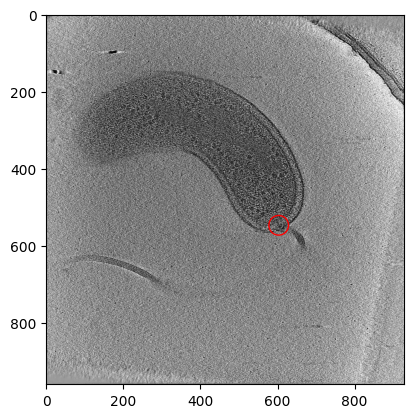

In [10]:
plt.imshow(slice_0169, cmap="gray")
plt.scatter(603, 546, s=200, marker="o", facecolors="none", edgecolors="r")
plt.show()

Bingo, nous distingons bien quelquechose qui ressemble bien à un flagelle qui se racore à une cellue au niveau de la zone en rouge. le centre du moteur est donc dans cette zone si nous fions à l'image ci-dessous.

## Reformulation du problème

En fait on ne distingue pas bien la structure d'un moteur mais plutôt le point de jonction entre le corps cellulaire et son flagelle. `Est-ce que le fait de juste détecter la jonction est un résultat acceptable pour le commanditaire ?`. Pour le commanditaire, une détection moteur distantes de 1000 angstrom du vrai centre du moteur est valable. Mais qu'est ce que 1000 angstroms dans notre cas d'usage ? retournons dans notre tableau voir !.

In [11]:
df[df.n_motors > 0].describe()

,row_id,z,y,x,axis0,axis1,axis2,vxs,n_motors,id,fold
count,451.000000,451.000000,451.000000,451.000000,451.000000,451.000000,451.000000,451.000000,451.000000,451.000000,451.000000
mean,359.246120,167.090909,482.467849,492.215078,354.545455,946.585366,936.248337,15.288027,1.842572,313.392461,4.421286
std,208.899389,78.083734,198.643513,214.836890,89.171269,16.501277,13.226588,2.456147,1.758675,183.937801,2.793626
min,1.000000,0.000000,59.000000,30.000000,300.000000,924.000000,928.000000,13.100000,1.000000,1.000000,0.000000
25%,182.500000,119.000000,333.000000,334.000000,300.000000,928.000000,928.000000,13.100000,1.000000,155.500000,2.000000
50%,354.000000,157.000000,491.000000,493.000000,300.000000,959.000000,928.000000,15.600000,1.000000,311.000000,5.000000
75%,529.500000,205.500000,633.000000,662.500000,500.000000,960.000000,956.000000,15.600000,2.000000,459.500000,7.000000
max,735.000000,466.000000,904.000000,902.000000,500.000000,960.000000,960.000000,19.700000,10.000000,646.000000,9.000000


D'après notre tableau, le `vxs` moyen est de  `15.28` avec des valeurs minimales et maximales respectivement à `13.1` et `19.70`. ce qui veut dire que nous avons une marge d'erreur de 51 voxels. Apprécions cette marge sur des exemples de notre dataset avec des vxs de 13.1 et 19.70.

In [12]:
df[df.vxs.isin([13.1, 19.7]) & df.n_motors > 0].groupby(
    by=["vxs", "tomo_id", "z", "x", "y", "axis1", "axis2"]
)[["n_motors"]].sum()

n_motors
vxs  tomo_id     z     x     y     axis1 axis2          
13.1 tomo_01a877 147.0 286.0 638.0 960   928           1
     tomo_033ebe 88.0  308.0 711.0 960   928           1
     tomo_0363f2 50.0  392.0 574.0 960   928           1
     tomo_0a8f05 52.0  575.0 587.0 928   928           1
     tomo_0da370 28.0  636.0 356.0 928   928           1
...                                                  ...
19.7 tomo_a9d067 250.0 564.0 657.0 924   956           3
     tomo_e22370 242.0 278.0 742.0 924   956           3
                 253.0 255.0 741.0 924   956           3
                 254.0 296.0 737.0 924   956           3
     tomo_ed1c97 241.0 186.0 64.0  924   956           1

[179 rows x 1 columns]

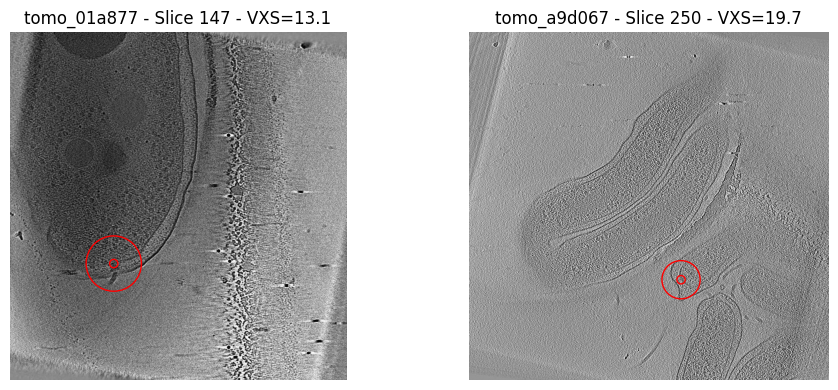

In [13]:
img_13 = load_image(
    "/kaggle/input/byu-locating-bacterial-flagellar-motors-2025/train/tomo_01a877/slice_0147.jpg"
).squeeze()
img_19 = load_image(
    "/kaggle/input/byu-locating-bacterial-flagellar-motors-2025/train/tomo_a9d067/slice_0250.jpg"
).squeeze()

r13 = 1000 / 13.1
r19 = 1000 / 19.7

fig, axes = plt.subplots(1, 2, figsize=(10, 4))

# Image 1
axes[0].imshow(img_13, cmap="gray")
axes[0].scatter(286, 638, edgecolors="r", facecolors="none")
axes[0].add_patch(plt.Circle((286, 638), radius=r13, fill=False, color="r"))
axes[0].set_title("tomo_01a877 - Slice 147 - VXS=13.1")
axes[0].axis("off")

# Image 2
axes[1].imshow(img_19, cmap="gray")
axes[1].scatter(564, 657, edgecolors="r", facecolors="none")
axes[1].add_patch(plt.Circle((564, 657), radius=r19, fill=False, color="r"))
axes[1].set_title("tomo_a9d067 - Slice 250 - VXS=19.7")
axes[1].axis("off")

plt.tight_layout()
plt.show()

De cette visualisation `il est clair que détecter la jonction entre le corps cellulaire et le flagelle est une approche viable qui est acceptable pour le commanditaire`.

### Qualification du problème, définition des objectifs et estimation des performances possibles

In [14]:
print("N unique tomo :", df.tomo_id.nunique())
print("N unique non-empty tomo :", df[df.n_motors > 0].tomo_id.nunique())

N unique tomo : 648
N unique non-empty tomo : 362


In [15]:
df.describe()

,row_id,z,y,x,axis0,axis1,axis2,vxs,n_motors,id,fold
count,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000,737.000000
mean,368.000000,101.861601,294.853460,300.818182,422.651289,950.207598,954.819539,15.341655,1.127544,320.971506,4.530529
std,212.897863,102.208293,282.325485,293.368799,174.341523,64.861948,97.229970,2.398197,1.642676,187.420506,2.861277
min,0.000000,-1.000000,-1.000000,-1.000000,300.000000,924.000000,924.000000,6.500000,0.000000,0.000000,0.000000
25%,184.000000,-1.000000,-1.000000,-1.000000,300.000000,928.000000,928.000000,13.100000,0.000000,157.000000,2.000000
50%,368.000000,106.000000,278.000000,280.000000,300.000000,959.000000,928.000000,15.600000,1.000000,323.000000,5.000000
75%,552.000000,170.000000,549.000000,567.000000,500.000000,960.000000,956.000000,16.800000,1.000000,481.000000,7.000000
max,736.000000,466.000000,904.000000,902.000000,800.000000,1912.000000,1847.000000,19.700000,10.000000,647.000000,9.000000


Au total le dataset contient `648 tomogrammes` parmi lesquels `362 sont vides`.  `Le problème consiste donc à dans un premier temps identifer les tomogrammes non-vides, puis identifier leurs positions à 50 voxels près`. 

Les tomogrammes non-vides contiennent en moyennes 2 moteurs, ce qui veut dire que le ratio signal bruit est très faible. 

Il va donc falloir équilibrer le nombre de tomogrammes vides / non vides, équilibrer le ratio signal bruit pour chaque tomogramme.

De plus les tomogrammes sont de tailles différentes, il va donc falloir soit `ramener les images sur une echelle commune en zoomant` soit réduire la taille de toutes les images à la même tailles, cad agrandir/réduire les échelles.

Sur l'une des images ci-dessus nous pouvons déjà constater que certaines d'entre elles peuvent `manquer de contrastes et pourraient être confondues avec des tomogrammes vides`.

De plus nous avons remarqués que les données décompressés étant énormement lourdes, elles doivent être stockés hors mémoire et chargé une à la fois, prétraités et directement enovyés au modèles.

Nous avons également remarqué que le process de lecture des tomogrammes pourrait constiuer un goulot d'étranglement et ralentir considérablement la vitesse d'entraînement.

Essayons maintenant de visualiser toutes nos donnés (qui est faisable dans notre cas) et voyons si d'autres observations peut s'ajouter.

In [16]:
from tqdm.auto import tqdm

In [17]:
21 // 10

2

  0%|          | 0/50 [00:00<?, ?it/s]

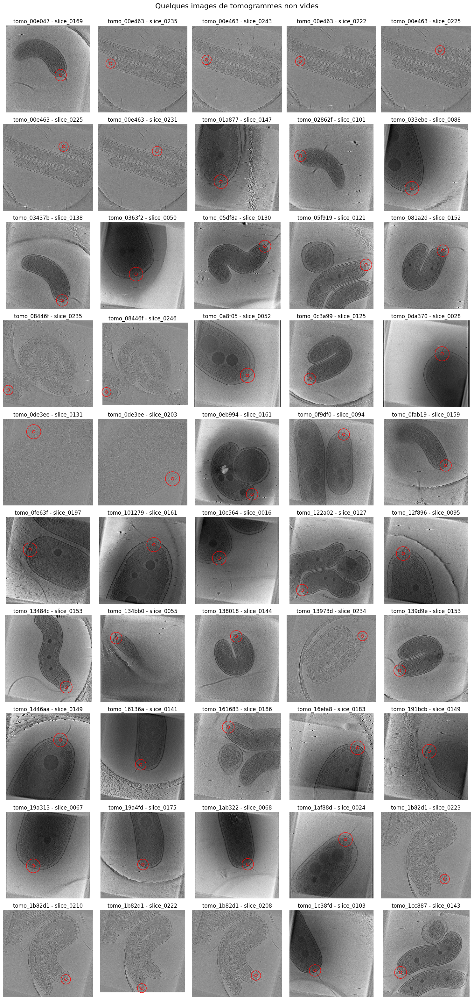

In [18]:
fig, axs = plt.subplots(10, 5, figsize=(15, 32))
fig.suptitle("Quelques images de tomogrammes non vides", fontsize=16)
counter = 0
displayed = 0
pbar = tqdm(total=50)
while displayed < 50:
    df_row = df.iloc[counter]
    counter += 1
    if df_row.z == -1:
        continue
    img = load_image(
        f"/kaggle/input/byu-locating-bacterial-flagellar-motors-2025/train/{df_row.tomo_id}/slice_{int(df_row.z):04d}.jpg"
    ).squeeze()
    row = displayed // 5
    col = displayed % 5
    ax = axs[row, col]
    ax.imshow(img, cmap="gray")
    ax.scatter(df_row.x, df_row.y, edgecolors="r", facecolors="none")
    ax.add_patch(
        plt.Circle(
            (df_row.x, df_row.y), radius=1000 / df_row.vxs, fill=False, color="r"
        )
    )
    ax.set_title(f"{df_row.tomo_id} - slice_{int(df_row.z):04d}")
    ax.axis("off")
    displayed += 1
    pbar.update(1)
pbar.close()
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()

  0%|          | 0/50 [00:00<?, ?it/s]

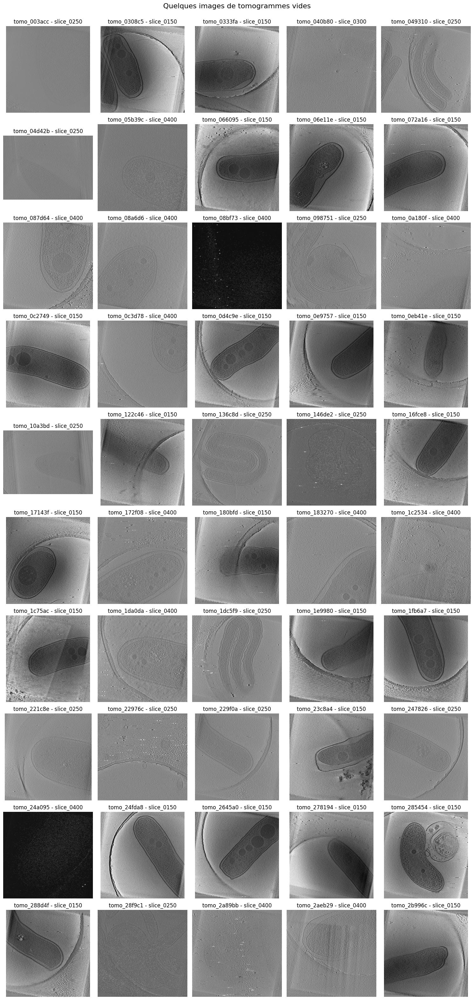

In [19]:
fig, axs = plt.subplots(10, 5, figsize=(15, 32))
fig.suptitle("Quelques images de tomogrammes vides", fontsize=16)
counter = 0
displayed = 0
pbar = tqdm(total=50)
while displayed < 50:
    df_row = df.iloc[counter]
    counter += 1
    if df_row.z > -1:
        continue
    img = load_image(
        f"/kaggle/input/byu-locating-bacterial-flagellar-motors-2025/train/{df_row.tomo_id}/slice_{int(df_row.axis0//2):04d}.jpg"
    ).squeeze()
    row = displayed // 5
    col = displayed % 5
    ax = axs[row, col]
    ax.imshow(img, cmap="gray")
    ax.set_title(f"{df_row.tomo_id} - slice_{int(df_row.axis0//2):04d}")
    ax.axis("off")
    displayed += 1
    pbar.update(1)
pbar.close()
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()

L'analyse des images confirme qu'il y'a effectivement 4 catégories d'images selon qu'elles soient vides / non vides, contrastés/ non contrastés.
- les non vides à faibles contrastes sont très vites confondus aux vides à faibles constrastes ce qui peut réprésenter un difficultés pour la distinction entre ces deux classes. Ce groupe vide à faible contraste peut réprésenter entre 10 et 20% des images.

`Ainsi on pourrait raisonnablement viser une performance supérieur à 80% de recall et 80% de F1-score pour notre système de détection.` Une performance au-delà de 90% serait exceptionnelle tant certains tomogrammes non vides sont très proches de tomogrammes vides.

# MODEL

The model is a 3D UNet builded using MONAI's FLexibleUnet as backbone. The encoder is a pre-trained `ResNetx` imported under the hood from ``. The decoder uses a two (02) deconvolution block before the segmentation head.
`Input = (B, 1, 96, 160, 160) -> 5 encoders layers -> 2 decoders blocks (deconv) -> (B, 2, 12, 20, 20, 20)`. A `deep supervision is also performed on the before last layer`.
la batch normalisation est synchronisé, notre batch effective est donc B*n_workers = 4 * 8 = 32 dans notre cas d'usage.
Les couche lienaires sont initialisés avec la methode de `xarvier` et les couches non linéaires avec la méthode de `kairming`.

# LOSS 

La fonction de perte à optimiser se présente comme une fonction composite calculé avec 3 contributions:
- Une `FocalLoss` sur la dernière couche de segmentations * 1
- Une `FocalLoss` calculée à partir d'un max pooling de la dernière couche de segmentation qui divise les dimensions par 2, pour augmenter le SNR et favoriser l'apparition de maximums locaux au niveau des moteurs
- `FocalLoss` de deep supervision qui divise les dimmensions de la sortie final par 4 et permet de favoriser l'apparition très tôt d'un signal pertinent.

# PREPROCESSING

- subdivion aléatoire des tomogrammes en 10 groupes
- Chargement des slices en utilisant du multi-threading pour annuler le goulot I/O
- Downsampling de l'image à 288, 480, 480 avec une interpolation `nearest-exact`
- Normalisation des donées pour avoir des input qui suivent une loi normales centrée et reduites. Cela est iportant pour une meilleur optimisation du modèle.
- Découpages de morceaux de 96, 160, 160 (autour d'un label si entrainement)

## Visualisation des données du preprocessing

In [21]:
from app.data import BYUCustomDataset

`BYUCustomDataset` est une Classe qui encapsule toute la logique de preprocessing de nos données.

In [98]:
# cfg.dataset_args.transforms.roi_size
# cfg.dataset_args.transforms.batch_size
cfg.dataset_args.transforms.ratios = [1, 4]
cfg.dataset_args.transforms.n_classes = 2

In [99]:
train_df, val_df = get_data(cfg, mode="fit")
dataset = BYUCustomDataset(cfg, df=train_df, mode="train")

no available indices of class 1 to crop, setting the crop ratio of this class to zero.
no available indices of class 1 to crop, setting the crop ratio of this class to zero.
no available indices of class 1 to crop, setting the crop ratio of this class to zero.
no available indices of class 1 to crop, setting the crop ratio of this class to zero.
no available indices of class 1 to crop, setting the crop ratio of this class to zero.
no available indices of class 1 to crop, setting the crop ratio of this class to zero.
no available indices of class 1 to crop, setting the crop ratio of this class to zero.
no available indices of class 1 to crop, setting the crop ratio of this class to zero.
no available indices of class 1 to crop, setting the crop ratio of this class to zero.
no available indices of class 1 to crop, setting the crop ratio of this class to zero.
no available indices of class 1 to crop, setting the crop ratio of this class to zero.
no available indices of class 1 to crop, se

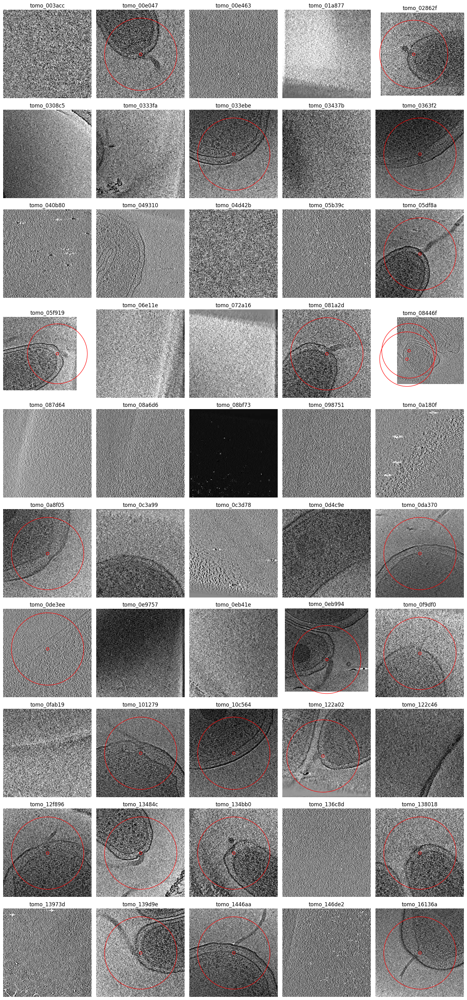

In [123]:
fig, axs = plt.subplots(10, 5, figsize=(15, 32))
for i in range(0, 50):
    data = dataset[i]
    img = data["input"].squeeze()
    target = data["target"].squeeze()
    tomo_id = df.loc[df.id == data["id"], "tomo_id"].iloc[0]
    row = i // 5
    col = i % 5
    ax = axs[row, col]
    zyx = torch.where(target == 1)
    if len(zyx[0]) >= 1:
        zyx = torch.stack(zyx).T
    else:
        zyx = None
    ax.imshow(img[int(img.shape[0] // 2)], cmap="gray")

    if zyx is not None:
        for z, y, x in zyx:
            ax.add_patch(plt.Circle((x, y), radius=1000 / 15.28, fill=False, color="r"))
            ax.scatter(x, y, edgecolors="r", facecolors="none")
    ax.set_title(f"{tomo_id}")
    ax.axis("off")
plt.tight_layout()
plt.show()

Nous remarquons sur ces résultats que notre strategies qui consiste à :
- Downsampling de l'image à 288, 480, 480 avec une interpolation `nearest-exact`
- Normalisation des donées pour avoir des input qui suivent une loi normales centrée et reduites. Cela est iportant pour une meilleur optimisation du modèle.
- Découpages de morceaux de 96, 160, 160 (autour d'un label si entrainement)

Le tout implémenté dans notre `BYUCustomDataset` conserve suffisamment de détails pour identifier `la jonction flagelle-cellule`. Notre stratégie est donc viable d'un point `observation humaine`. Une démarche automatisation de cette tâche de détection avec un modèle peut donc être entreprise. L'objectif èst de faire aussi bien que l'oeil humain`, voire mieux si nous parvenons à traiter la difficulté apparente des image faiblement contrasté non vides.

En plus, nous allons dans un premier temps que considérer les images non vides, car nous allons pas perdres en représentativités des voxels, puisques les images non vides contiennent des zones similaires aux images vides.

`Notre jeu de données d'entraînement est finalement de 286 tomogrammes, que nous repartir en 10 groupes de manières aléatoire.` le résultat de cette répartition est consigné dans le fichier `byu_folded_non_empty_tomograms_seed57.csv`.



# POST PROCESSSING

- Upsampling de la dernière couche de segmentation + reconstruction du tomogramme
- Non maximum suppression pour nettoyer les carte de prediction
- Ensuite le top10 des des coordonnées dans chaque tomogrammes est gardé comme points candidats.

# CUSTOM EVALUATION METRIC